In [1]:
#add path to sys so that we can import functions from other folders
import sys
sys.path.append(r"C:\Users\tfarotimi\United Nations\Contexto Proyecciones Sector Externo - ProyectoAutomatización\Dev\Inflation Forecasting\src")
sys.path.append(r"C:\Users\tfarotimi\United Nations\Contexto Proyecciones Sector Externo - ProyectoAutomatización\Dev\Inflation Forecasting\lib")

#import libraries 
import pandas as pd
import numpy as np
import plotly.graph_objs as go
import plotly.offline as pyo
from plotly.subplots import make_subplots
pyo.init_notebook_mode()
import nbformat

import matplotlib.pyplot as plt
import seaborn as sns

#tqdm
from tqdm import tqdm


#scikit-learn
#randomforestregessor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error,r2_score


from forestci import random_forest_error

#statsmodels
from statsmodels.tsa.ar_model import AutoReg
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import ARIMA

import pmdarima as pm
from pmdarima.arima import ADFTest

%pip install tsmoothie 
import tsmoothie as ts


#import functions from modules
from models import arima
from helper_functions import load_data, prepare_data, prepare_forecast_data, format_results,step_forecast, time_delay_embedding
from dashboard import model_compare, r2_compare, error_compare
from residuals_analysis import analyze_residuals
from forecast import get_forecast 

#import modules
import importlib
import models
import helper_functions
import dashboard
import residuals_analysis
import forecast

#reload modules to ensure that changes made to them are reflected in the notebook
importlib.reload(models)
importlib.reload(helper_functions)
importlib.reload(dashboard)
importlib.reload(residuals_analysis)
importlib.reload(forecast)



%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import pandas_datareader as pdr
import seaborn as sns
from statsmodels.tsa.api import acf, graphics, pacf
from statsmodels.tsa.ar_model import AutoReg, ar_select_order

sns.set_style("darkgrid")
pd.plotting.register_matplotlib_converters()
# Default figure size
sns.mpl.rc("figure", figsize=(16, 6))
sns.mpl.rc("font", size=14)



Failed to import duecredit due to No module named 'duecredit'


Note: you may need to restart the kernel to use updated packages.


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\tqdm\auto.py:22: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html



In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
institutions = { 
"Argentina":'ARG_ALL',
"Bolivia":'BOL_NSO',
"Brazil":'BRA_CB',
"Chile":'CHL_CB',
"Mexico":'MEX_CB'
}

start_dates = {'Argentina': '2019-04-01 00:00:00',
                'Bolivia': '2019-08-01 00:00:00',
                'Brazil': '2000-06-01 00:00:00',
                'Chile': '1975-12-01 00:00:00',
                'Mexico': '2013-06-01 00:00:00'}





In [4]:
#read data from csv files
inst_data = {}
for inst in institutions:
    path = "C:\\Users\\tfarotimi\\United Nations\Contexto Proyecciones Sector Externo - ProyectoAutomatización\\Dev\\Inflation Forecasting\dat\\" + institutions[inst] + "_Inflation_Time_Series_Data_raw2023-07-18.csv"
    
    inst_data[inst] = load_data(path)

    if(inst == 'Argentina'):
        #get percentage change from CPI values 
        inst_data[inst]['IPCA YOY %'] = inst_data['Argentina']['inflacion_interanual_ARG_ALL'].pct_change(periods=12)*100
        inst_data[inst] = inst_data[inst].dropna(subset = ['IPCA YOY %'])
        inst_data[inst] = inst_data[inst].drop(columns = ['inflacion_interanual_ARG_ALL'])



100%|██████████| 100/100 [00:00<00:00, 328.02it/s]


In [5]:
def auto_arima_grid_search(data):


    data = data.dropna()

    adf_test = ADFTest(alpha=0.05)
    diff_bool = adf_test.should_diff(data)
    
    print(adf_test.is_stationary(data))
    print(diff_bool)
    
    if (diff_bool[1] == True):
        DIFF_VAL = 1
    else:
        DIFF_VAL = None

    auto = pm.auto_arima(data, start_p=0, d=1, start_q=0,
                            test='adf',       # use adftest to find optimal 'd'
                            max_p=3, max_q=3,
                            start_P = 0, start_Q=0,
                            D=DIFF_VAL,
                            max_P = 3,  max_Q = 3,max_D=3,
                            seasonal = True,
                            m=12,             
                            stepwise=True,
                            out_of_sample_size = 12,
                            scoring='mse',
                            information_criterion = 'oob'
                           ) 
    
    


    print(auto.summary())
    print(auto.plot_diagnostics)
    
    #make predictions
    params = [auto.get_params()['order'], auto.get_params()['seasonal_order']]
    return params



In [6]:
def arima_dateSearch(data, country, target, params):
    last_train_date = data.index[-12] - pd.DateOffset(months=12)
    begin_date = data.index[0]
    target = data.columns[-1]

    rmse_list = pd.DataFrame()

    print("Running ARIMA model to find best date to start training...")
    for i in tqdm(pd.date_range(begin_date, last_train_date, freq='MS')):
        

        try:
            rmse = arima(data[i:], country, target, params).meta['rmse']
            

            #add rmse to list
            rmse_list = rmse_list.append(pd.DataFrame([rmse], columns=['rmse'], index=[i]))
            #get index of min rmse
        
            min_rmse_index = rmse_list['rmse'].idxmin().strftime('%Y-%m-%d')
        except:
            print( i, last_train_date)
            print ("error - returning index with lowest rmse")
            print ("failed on: ", i, last_train_date)
            print ("rmse_list: ", rmse_list)
            break 
            
          
    print (rmse_list)
    return min_rmse_index        


In [9]:
data = inst_data['Mexico']

config = {"model": arima, 
"params": auto_arima_grid_search(data),
"data":data,         
"country": 'Mexico',
"indicator": "Inflation",	
    "target": data.columns[-1],
    "walk_forward": False,
    "lags": 12,
    "predictors": None
    }

data2 = remove_pulses(data)

config2 = {"model": arima, 
"params": auto_arima_grid_search(data2),
"data":data2,         
"country": 'Mexico',
"indicator": "Inflation",	
    "target": data.columns[-1],
    "walk_forward": False,
    "lags": 12,
    "predictors": None
    }




get_forecast(config)
get_forecast(config2)

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_29984\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.011205246456581, False)
(0.011205246456581, False)


KeyboardInterrupt: 

In [ ]:
model_compare([config,config2])

This is the format of your plot grid:
[ (1,1) x,y   ]  [ (1,2) x2,y2 ]



c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\plotly\basedatatypes.py:2297: DeprecationWarning:

The append_trace method is deprecated and will be removed in a future version.
Please use the add_trace method with the row and col parameters.




[            Actual  Predicted
 Date                         
 2022-07-01    8.15   8.264271
 2022-08-01    8.70   8.303036
 2022-09-01    8.70   8.114880
 2022-10-01    8.41   7.953967
 2022-11-01    7.80   7.660334
 2022-12-01    7.82   7.745032
 2023-01-01    7.91   7.753628
 2023-02-01    7.62   7.518576
 2023-03-01    6.85   7.121959
 2023-04-01    6.25   6.580092
 2023-05-01    5.84   6.525125
 2023-06-01    5.06   6.269077,
             Actual  Predicted
 Date                         
 2022-07-01    8.15   8.203335
 2022-08-01    8.70   8.456545
 2022-09-01    8.70   8.257805
 2022-10-01    8.41   8.089888
 2022-11-01    7.80   7.695513
 2022-12-01    7.82   7.772503
 2023-01-01    7.91   7.808297
 2023-02-01    7.62   7.562505
 2023-03-01    6.85   7.227141
 2023-04-01    6.25   6.783346
 2023-05-01    5.84   6.723505
 2023-06-01    5.06   6.440785]

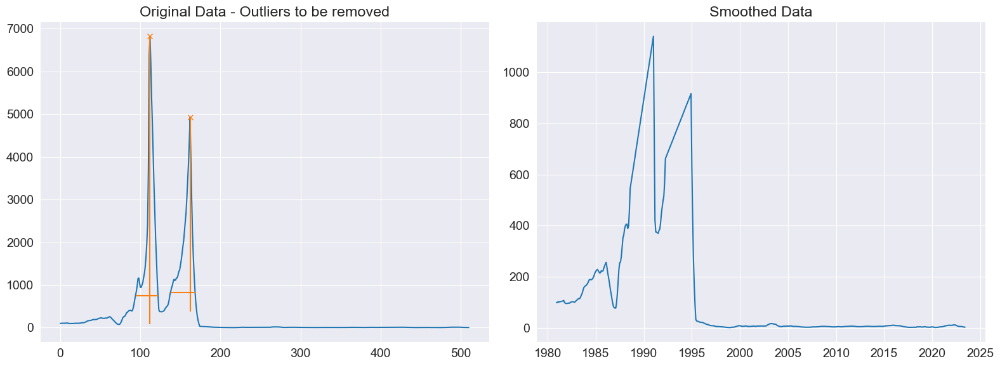

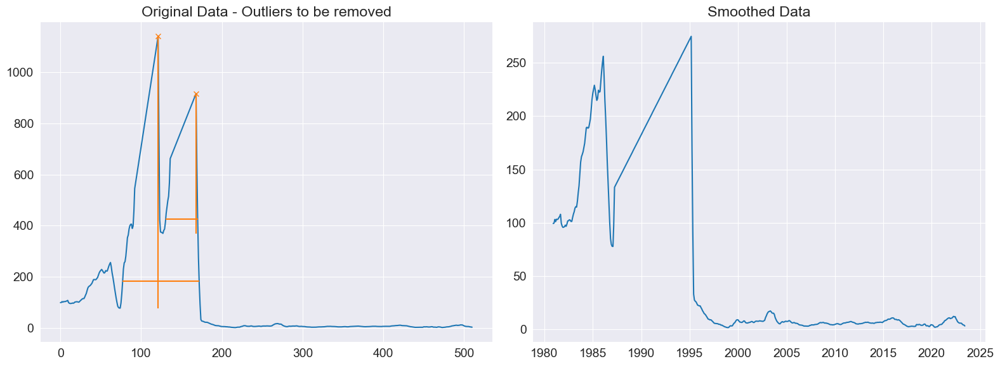

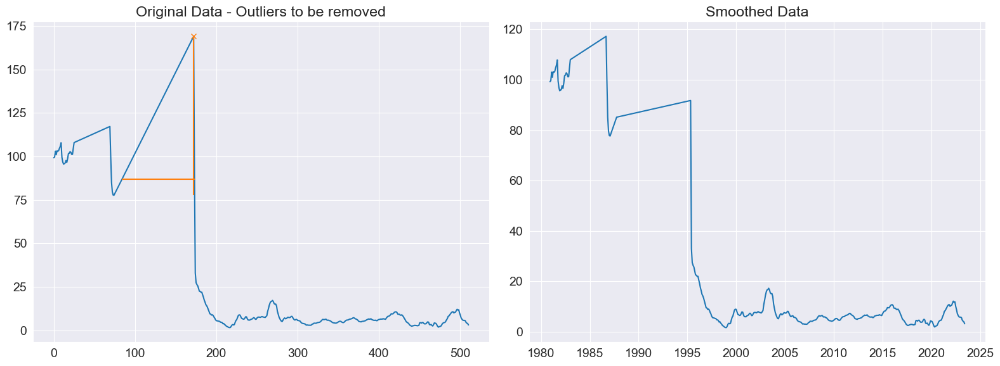

In [ ]:
b2 = remove_pulses(inst_data['Brazil'])
b3 = remove_pulses(b2)
b4 = remove_pulses(b3)
b5 = remove_pulses(b4)


In [ ]:
for b in [b2,b3,b4,b5]:
    list = []
    config = {"model": arima, 
"params": auto_arima_grid_search(b),
"data":b,         
"country": 'Brazil',
"indicator": "Inflation",	
    "target": b.columns[-1],
    "walk_forward": False,
    "lags": 12,
    "predictors": None
    }
    list.append(config)
    get_forecast(config)

model_compare(list)


C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.22716726797071662, True)
(0.22716726797071662, True)
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  511
Model:             SARIMAX(1, 1, 0)x(0, 1, 0, 12)   Log Likelihood               -2476.769
Date:                            Mon, 31 Jul 2023   AIC                           4957.537
Time:                                    10:49:06   BIC                           4965.958
Sample:                                         0   HQIC                          4960.842
                                            - 511                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6431      0.013     48.676      0.000    

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.33311576599590953, True)
(0.33311576599590953, True)
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  511
Model:             SARIMAX(1, 1, 0)x(0, 1, 0, 12)   Log Likelihood               -1747.637
Date:                            Mon, 31 Jul 2023   AIC                           3499.274
Time:                                    10:49:19   BIC                           3507.696
Sample:                                         0   HQIC                          3502.579
                                            - 511                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6493      0.017     37.336      0.000    

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.49077789023733065, True)
(0.49077789023733065, True)
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  511
Model:             SARIMAX(1, 1, 0)x(0, 1, 0, 12)   Log Likelihood               -1555.822
Date:                            Mon, 31 Jul 2023   AIC                           3115.644
Time:                                    10:49:31   BIC                           3124.065
Sample:                                         0   HQIC                          3118.949
                                            - 511                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5118      0.010     49.582      0.000    

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.7689130581735834, True)
(0.7689130581735834, True)
                                      SARIMAX Results                                      
Dep. Variable:                                   y   No. Observations:                  511
Model:             SARIMAX(2, 1, 3)x(0, 1, [], 12)   Log Likelihood               -1404.330
Date:                             Mon, 31 Jul 2023   AIC                           2820.660
Time:                                     10:50:41   BIC                           2845.923
Sample:                                          0   HQIC                          2830.575
                                             - 511                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1687     23.241      0.007      0.9

This is the format of your plot grid:
[ (1,1) x,y ]



c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\plotly\basedatatypes.py:2297: DeprecationWarning:

The append_trace method is deprecated and will be removed in a future version.
Please use the add_trace method with the row and col parameters.




[            Actual  Predicted
 Date                         
 2022-07-01   10.07  12.470017
 2022-08-01    8.73  13.152465
 2022-09-01    7.17  13.708877
 2022-10-01    6.47  14.124960
 2022-11-01    5.90  14.192258
 2022-12-01    5.79  13.511146
 2023-01-01    5.77  13.830539
 2023-02-01    5.60  13.990257
 2023-03-01    4.65  14.750113
 2023-04-01    4.18  15.580044
 2023-05-01    3.94  15.180010
 2023-06-01    3.16  15.339993]

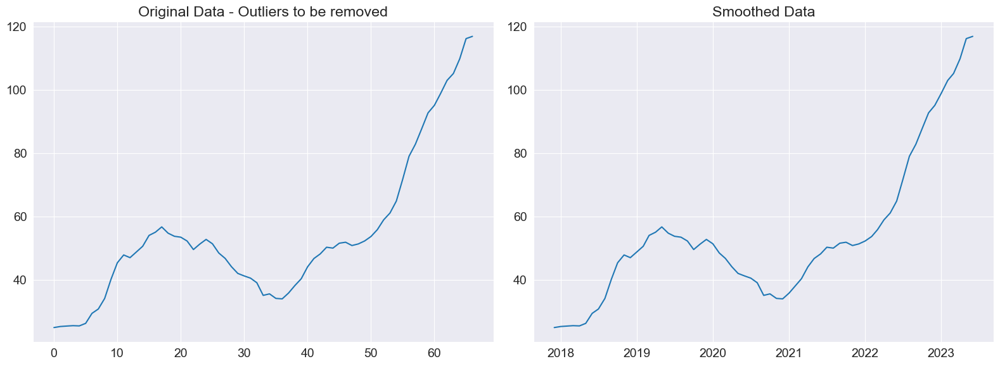

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.807013268001573, True)
(0.807013268001573, True)
                                      SARIMAX Results                                      
Dep. Variable:                                   y   No. Observations:                   67
Model:             SARIMAX(1, 1, 3)x(1, 1, [], 12)   Log Likelihood                -122.410
Date:                             Mon, 31 Jul 2023   AIC                            258.821
Time:                                     11:57:16   BIC                            272.744
Sample:                                          0   HQIC                           264.190
                                              - 67                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0813      0.225      0.361      0.718

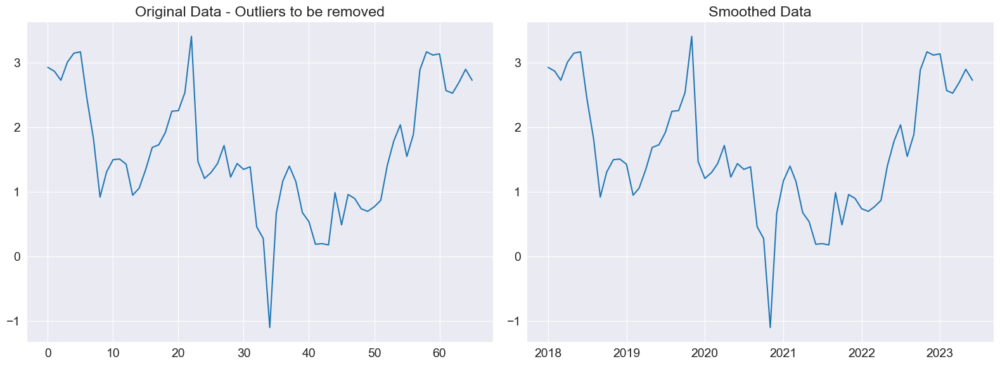

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.6923543672451788, True)
(0.6923543672451788, True)
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                   66
Model:             SARIMAX(0, 1, 0)x(0, 1, 0, 12)   Log Likelihood                 -71.122
Date:                            Mon, 31 Jul 2023   AIC                            144.244
Time:                                    11:57:20   BIC                            146.215
Sample:                                         0   HQIC                           145.002
                                             - 66                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.8572      0.096      8.914      0.000      

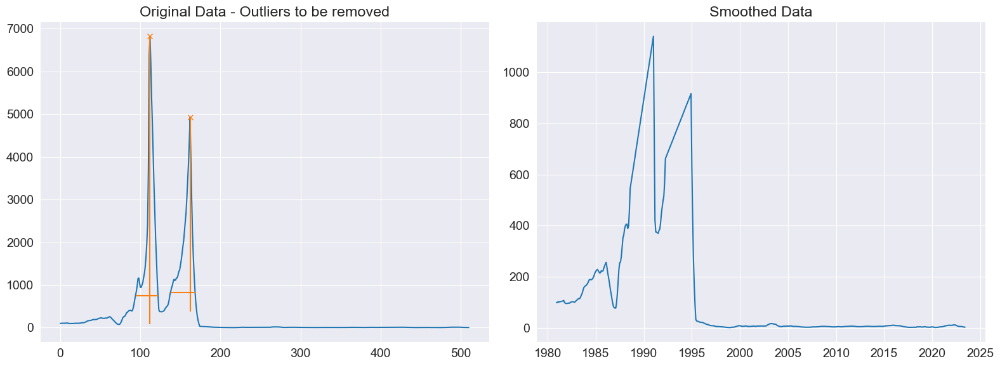

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.22716726797071662, True)
(0.22716726797071662, True)
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  511
Model:             SARIMAX(1, 1, 0)x(0, 1, 0, 12)   Log Likelihood               -2476.769
Date:                            Mon, 31 Jul 2023   AIC                           4957.537
Time:                                    11:57:37   BIC                           4965.958
Sample:                                         0   HQIC                          4960.842
                                            - 511                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6431      0.013     48.676      0.000    

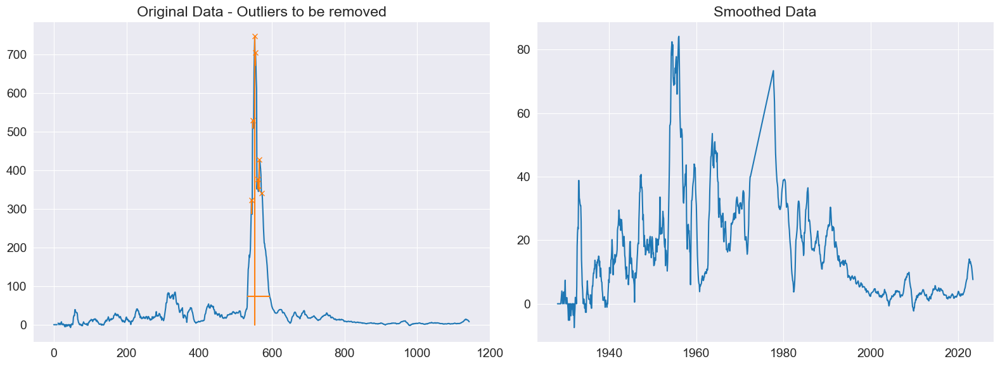

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.01, False)
(0.01, False)
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                 1144
Model:             SARIMAX(3, 1, 0)x(2, 0, 0, 12)   Log Likelihood               -2438.027
Date:                            Mon, 31 Jul 2023   AIC                           4888.055
Time:                                    11:59:30   BIC                           4918.303
Sample:                                         0   HQIC                          4899.477
                                           - 1144                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2481      0.016     15.518      0.000       0.217       0.279
ar.L2  

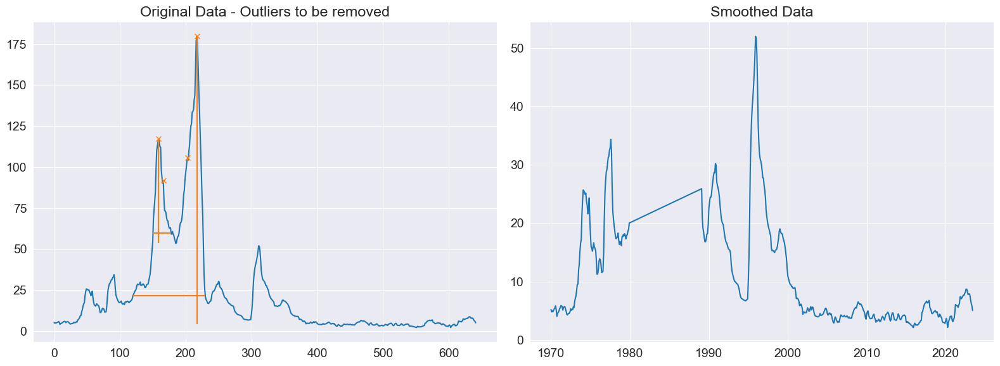

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.01, False)
(0.01, False)
                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                  642
Model:             SARIMAX(0, 1, 2)x(0, 0, [1], 12)   Log Likelihood                -644.962
Date:                              Mon, 31 Jul 2023   AIC                           1299.925
Time:                                      12:00:28   BIC                           1322.240
Sample:                                           0   HQIC                          1308.586
                                              - 642                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     -0.0028      0.024     -0.118      0.906      -0.049    

c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\plotly\basedatatypes.py:2297: DeprecationWarning:

The append_trace method is deprecated and will be removed in a future version.
Please use the add_trace method with the row and col parameters.




[                Actual  Predicted
 Date                             
 2022-07-01   71.828398  67.961630
 2022-08-01   79.109169  69.200166
 2022-09-01   82.902489  69.980634
 2022-10-01   87.800198  71.891832
 2022-11-01   92.817300  71.938981
 2022-12-01   95.190825  73.196571
 2023-01-01   99.009676  75.441165
 2023-02-01  103.061044  78.037151
 2023-03-01  105.252083  80.795454
 2023-04-01  109.889015  84.720437
 2023-05-01  116.258569  87.531931
 2023-06-01  116.972586  90.574950,
             Actual  Predicted
 Date                         
 2022-07-01    2.04       1.80
 2022-08-01    1.55       1.78
 2022-09-01    1.89       2.59
 2022-10-01    2.89       2.09
 2022-11-01    3.17       2.56
 2022-12-01    3.12       2.50
 2023-01-01    3.14       2.34
 2023-02-01    2.57       2.30
 2023-03-01    2.53       2.37
 2023-04-01    2.70       2.47
 2023-05-01    2.90       3.01
 2023-06-01    2.73       3.39,
             Actual  Predicted
 Date                         
 2022-07-01 

In [ ]:
config_list = []

for country in inst_data:    
  
  data = remove_pulses(inst_data[country])
  
  params = auto_arima_grid_search(data)

  config = {"model": arima, 
    "params": params,
    "data":data,         
    "country": country,
    "indicator": "Inflation",	
      "target": data.columns[-1],
        "walk_forward": False,
        "lags": 12,
        "predictors": None
        }

  config_list.append(config)
  

  

len(config_list)
model_compare(config_list)



In [ ]:
config_list = []

for country in inst_data:    
  
  data = inst_data[country]
  
  params = auto_arima_grid_search(data)

  config = {"model": arima, 
    "params": params,
    "data":data,         
    "country": country,
    "indicator": "Inflation",	
      "target": data.columns[-1],
        "walk_forward": False,
        "lags": 12,
        "predictors": None
        }

  config_list.append(config)
  

  

len(config_list)
model_compare(config_list)



C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.807013268001573, True)
(0.807013268001573, True)
                                      SARIMAX Results                                      
Dep. Variable:                                   y   No. Observations:                   67
Model:             SARIMAX(1, 1, 3)x(1, 1, [], 12)   Log Likelihood                -122.410
Date:                             Mon, 31 Jul 2023   AIC                            258.821
Time:                                     13:37:07   BIC                            272.744
Sample:                                          0   HQIC                           264.190
                                              - 67                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0813      0.225      0.361      0.718

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                   66
Model:             SARIMAX(0, 1, 0)x(0, 1, 0, 12)   Log Likelihood                 -71.122
Date:                            Mon, 31 Jul 2023   AIC                            144.244
Time:                                    13:37:10   BIC                            146.215
Sample:                                         0   HQIC                           145.002
                                             - 66                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.8572      0.096      8.914      0.000       0.669       1.046
Ljung-Box (L1) (Q):                

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                  511
Model:             SARIMAX(0, 1, 0)x(2, 0, [1], 12)   Log Likelihood               -3385.579
Date:                              Mon, 31 Jul 2023   AIC                           6781.158
Time:                                      13:38:03   BIC                           6802.330
Sample:                                           0   HQIC                          6789.459
                                              - 511                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     -0.1935     10.069     -0.019      0.985     -19.929      19.542
ar.S.L12      -0.02

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.

c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in 

                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                 1142
Model:             SARIMAX(3, 1, 0)x(2, 0, [1], 12)   Log Likelihood               -4377.054
Date:                              Mon, 31 Jul 2023   AIC                           8770.108
Time:                                      13:42:20   BIC                           8810.425
Sample:                                           0   HQIC                          8785.333
                                             - 1142                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0011      0.136      0.008      0.994      -0.266       0.268
ar.L1          0.18

C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_41784\3327499855.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



                                        SARIMAX Results                                        
Dep. Variable:                                       y   No. Observations:                  642
Model:             SARIMAX(0, 1, 1)x(1, 0, [1, 2], 12)   Log Likelihood               -1300.509
Date:                                 Mon, 31 Jul 2023   AIC                           2613.019
Time:                                         13:43:35   BIC                           2639.797
Sample:                                              0   HQIC                          2623.412
                                                 - 642                                         
Covariance Type:                                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     -0.0067      0.111     -0.060      0.952      -0.224       0

c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\plotly\basedatatypes.py:2297: DeprecationWarning:

The append_trace method is deprecated and will be removed in a future version.
Please use the add_trace method with the row and col parameters.




[                Actual  Predicted
 Date                             
 2022-07-01   71.828398  67.961630
 2022-08-01   79.109169  69.200166
 2022-09-01   82.902489  69.980634
 2022-10-01   87.800198  71.891832
 2022-11-01   92.817300  71.938981
 2022-12-01   95.190825  73.196571
 2023-01-01   99.009676  75.441165
 2023-02-01  103.061044  78.037151
 2023-03-01  105.252083  80.795454
 2023-04-01  109.889015  84.720437
 2023-05-01  116.258569  87.531931
 2023-06-01  116.972586  90.574950,
             Actual  Predicted
 Date                         
 2022-07-01    2.04       1.80
 2022-08-01    1.55       1.78
 2022-09-01    1.89       2.59
 2022-10-01    2.89       2.09
 2022-11-01    3.17       2.56
 2022-12-01    3.12       2.50
 2023-01-01    3.14       2.34
 2023-02-01    2.57       2.30
 2023-03-01    2.53       2.37
 2023-04-01    2.70       2.47
 2023-05-01    2.90       3.01
 2023-06-01    2.73       3.39,
             Actual  Predicted
 Date                         
 2022-07-01 

In [ ]:
config_list = []
best_start_config_list = []

for inst in tqdm(inst_data):
  #start_dt = start_dates[inst]
  data = inst_data[inst]
  target = data.columns[-1]

  params = auto_arima_grid_search(data)



  #best_start_dt = arima_dateSearch(data, inst, target, params)

  #print (inst + ": Best start date: " + best_start_dt)




  model_config = {"model": arima, 
        "params": params,
        "data":data,         
        "country": inst,
        "indicator": "Inflation",	
          "target": inst_data[inst].columns[-1],
            "walk_forward": False,
            "lags": 12,
            "predictors": None
            }
  

  '''
    best_start_config ={"model": arima, 
            "params": params,
            "data":data[best_start_dt:],         
            "country": inst,
            "indicator": "Inflation",	
              "target": inst_data[inst].columns[-1],
                "walk_forward": False,
                "lags": 12,
                "predictors": None
                }
  '''
  config_list.append(model_config)
  get_forecast(model_config)

  #best_start_config_list.append(best_start_config)

model_compare(config_list)
  



  0%|          | 0/5 [00:00<?, ?it/s]C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_37776\511490315.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.807013268001573, True)
(0.807013268001573, True)
Performing stepwise search to minimize oob
 ARIMA(0,1,0)(0,1,0)[12]             : OOB=752.752, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[12]             : OOB=680.497, Time=0.24 sec
 ARIMA(0,1,1)(0,1,1)[12]             : OOB=inf, Time=0.28 sec
 ARIMA(1,1,0)(0,1,0)[12]             : OOB=605.141, Time=0.08 sec
 ARIMA(1,1,0)(0,1,1)[12]             : OOB=inf, Time=0.29 sec
 ARIMA(1,1,0)(1,1,1)[12]             : OOB=inf, Time=0.40 sec
 ARIMA(2,1,0)(0,1,0)[12]             : OOB=598.708, Time=0.10 sec
 ARIMA(2,1,0)(1,1,0)[12]             : OOB=623.521, Time=0.17 sec
 ARIMA(2,1,0)(0,1,1)[12]             : OOB=inf, Time=0.38 sec
 ARIMA(2,1,0)(1,1,1)[12]             : OOB=inf, Time=0.43 sec
 ARIMA(3,1,0)(0,1,0)[12]             : OOB=592.177, Time=0.10 sec
 ARIMA(3,1,0)(1,1,0)[12]             : OOB=543.193, Time=0.18 sec
 ARIMA(3,1,0)(2,1,0)[12]             : OOB=711.687, Time=0.42 sec
 ARIMA(3,1,0)(1,1,1)[12]             : OOB=inf, Time=0.57 sec
 ARIM

 20%|██        | 1/5 [00:48<03:15, 48.81s/it]C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_37776\511490315.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.6923543672451788, True)
(0.6923543672451788, True)
Performing stepwise search to minimize oob
 ARIMA(0,1,0)(0,1,0)[12]             : OOB=0.270, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : OOB=2.068, Time=0.24 sec
 ARIMA(0,1,1)(0,1,1)[12]             : OOB=inf, Time=0.33 sec
 ARIMA(0,1,0)(1,1,0)[12]             : OOB=2.038, Time=0.13 sec
 ARIMA(0,1,0)(0,1,1)[12]             : OOB=inf, Time=0.40 sec
 ARIMA(0,1,0)(1,1,1)[12]             : OOB=inf, Time=0.60 sec
 ARIMA(1,1,0)(0,1,0)[12]             : OOB=0.309, Time=0.07 sec
 ARIMA(0,1,1)(0,1,0)[12]             : OOB=0.320, Time=0.09 sec
 ARIMA(1,1,1)(0,1,0)[12]             : OOB=0.281, Time=0.19 sec
 ARIMA(0,1,0)(0,1,0)[12] intercept   : OOB=0.453, Time=0.13 sec

Best model:  ARIMA(0,1,0)(0,1,0)[12]          
Total fit time: 2.284 seconds
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                   66
Model:   

 40%|████      | 2/5 [00:51<01:05, 21.75s/it]C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_37776\511490315.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.01, False)
(0.01, False)
Performing stepwise search to minimize oob
 ARIMA(0,1,0)(0,0,0)[12] intercept   : OOB=24.794, Time=0.15 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : OOB=27.739, Time=0.53 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : OOB=25.659, Time=0.64 sec
 ARIMA(0,1,0)(0,0,0)[12]             : OOB=38.862, Time=0.09 sec
 ARIMA(0,1,0)(1,0,0)[12] intercept   : OOB=19.727, Time=0.50 sec
 ARIMA(0,1,0)(2,0,0)[12] intercept   : OOB=17.405, Time=1.05 sec
 ARIMA(0,1,0)(3,0,0)[12] intercept   : OOB=16.286, Time=5.24 sec
 ARIMA(0,1,0)(3,0,1)[12] intercept   : OOB=20.083, Time=5.92 sec
 ARIMA(0,1,0)(2,0,1)[12] intercept   : OOB=15.822, Time=2.12 sec
 ARIMA(0,1,0)(1,0,1)[12] intercept   : OOB=15.954, Time=1.27 sec
 ARIMA(0,1,0)(2,0,2)[12] intercept   : OOB=18.778, Time=5.39 sec
 ARIMA(0,1,0)(1,0,2)[12] intercept   : OOB=16.078, Time=3.02 sec
 ARIMA(0,1,0)(3,0,2)[12] intercept   : OOB=26.140, Time=9.63 sec
 ARIMA(1,1,0)(2,0,1)[12] intercept   : OOB=24.846, Time=2.05 sec
 ARIMA(0,1,1)(2,0,1

 60%|██████    | 3/5 [01:44<01:11, 35.74s/it]C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_37776\511490315.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.

c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



(0.022692622348321125, False)
(0.022692622348321125, False)
Performing stepwise search to minimize oob
 ARIMA(0,1,0)(0,0,0)[12] intercept   : OOB=4.644, Time=0.14 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(1,1,0)(1,0,0)[12] intercept   : OOB=1.642, Time=0.94 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(0,1,1)(0,0,1)[12] intercept   : OOB=2.575, Time=0.98 sec
 ARIMA(0,1,0)(0,0,0)[12]             : OOB=4.396, Time=0.07 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.

c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(1,1,0)(0,0,0)[12] intercept   : OOB=4.844, Time=0.15 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(1,1,0)(2,0,0)[12] intercept   : OOB=1.395, Time=2.95 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(1,1,0)(3,0,0)[12] intercept   : OOB=1.566, Time=11.02 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(1,1,0)(2,0,1)[12] intercept   : OOB=1.918, Time=4.47 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(1,1,0)(1,0,1)[12] intercept   : OOB=1.918, Time=1.15 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(1,1,0)(3,0,1)[12] intercept   : OOB=1.921, Time=12.46 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(0,1,0)(2,0,0)[12] intercept   : OOB=1.703, Time=1.72 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(2,1,0)(2,0,0)[12] intercept   : OOB=1.185, Time=4.00 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(2,1,0)(1,0,0)[12] intercept   : OOB=1.581, Time=1.48 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(2,1,0)(3,0,0)[12] intercept   : OOB=1.246, Time=12.49 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(2,1,0)(2,0,1)[12] intercept   : OOB=1.521, Time=6.89 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(2,1,0)(1,0,1)[12] intercept   : OOB=1.523, Time=3.27 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(2,1,0)(3,0,1)[12] intercept   : OOB=1.511, Time=17.64 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(3,1,0)(2,0,0)[12] intercept   : OOB=1.143, Time=5.66 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(3,1,0)(1,0,0)[12] intercept   : OOB=1.896, Time=2.73 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(3,1,0)(3,0,0)[12] intercept   : OOB=0.916, Time=18.26 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(3,1,0)(3,0,1)[12] intercept   : OOB=0.910, Time=19.21 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(3,1,0)(2,0,1)[12] intercept   : OOB=0.909, Time=9.15 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(3,1,0)(1,0,1)[12] intercept   : OOB=0.910, Time=3.97 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(3,1,0)(2,0,2)[12] intercept   : OOB=0.910, Time=10.12 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(3,1,0)(1,0,2)[12] intercept   : OOB=0.910, Time=7.60 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(3,1,0)(3,0,2)[12] intercept   : OOB=0.910, Time=22.61 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(3,1,1)(2,0,1)[12] intercept   : OOB=1.827, Time=10.17 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(2,1,1)(2,0,1)[12] intercept   : OOB=3.375, Time=13.58 sec


c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: DeprecationWarning:

No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.



 ARIMA(3,1,0)(2,0,1)[12]             : OOB=0.924, Time=6.60 sec

Best model:  ARIMA(3,1,0)(2,0,1)[12] intercept
Total fit time: 211.590 seconds
                                      SARIMAX Results                                       
Dep. Variable:                                    y   No. Observations:                 1142
Model:             SARIMAX(3, 1, 0)x(2, 0, [1], 12)   Log Likelihood               -4377.054
Date:                              Tue, 25 Jul 2023   AIC                           8770.108
Time:                                      21:22:05   BIC                           8810.425
Sample:                                           0   HQIC                          8785.333
                                             - 1142                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------

 80%|████████  | 4/5 [05:24<01:48, 108.86s/it]C:\Users\tfarotimi\AppData\Local\Temp\ipykernel_37776\511490315.py:9: DeprecationWarning:

is_stationary is deprecated and will be removed in a future release of pmdarima. Use should_diff instead.



(0.011205246456581, False)
(0.011205246456581, False)
Performing stepwise search to minimize oob
 ARIMA(0,1,0)(0,0,0)[12] intercept   : OOB=1.644, Time=0.23 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : OOB=2.270, Time=0.97 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : OOB=0.254, Time=0.79 sec
 ARIMA(0,1,0)(0,0,0)[12]             : OOB=1.579, Time=0.14 sec
 ARIMA(0,1,1)(0,0,0)[12] intercept   : OOB=2.023, Time=0.30 sec
 ARIMA(0,1,1)(1,0,1)[12] intercept   : OOB=0.257, Time=0.88 sec
 ARIMA(0,1,1)(0,0,2)[12] intercept   : OOB=0.255, Time=1.90 sec
 ARIMA(0,1,1)(1,0,0)[12] intercept   : OOB=1.151, Time=0.97 sec
 ARIMA(0,1,1)(1,0,2)[12] intercept   : OOB=0.208, Time=5.20 sec
 ARIMA(0,1,1)(2,0,2)[12] intercept   : OOB=inf, Time=8.77 sec
 ARIMA(0,1,1)(1,0,3)[12] intercept   : OOB=inf, Time=10.86 sec
 ARIMA(0,1,1)(0,0,3)[12] intercept   : OOB=0.241, Time=7.27 sec
 ARIMA(0,1,1)(2,0,1)[12] intercept   : OOB=0.242, Time=2.85 sec
 ARIMA(0,1,1)(2,0,3)[12] intercept   : OOB=inf, Time=18.07 sec
 ARIMA(0,1,

100%|██████████| 5/5 [06:58<00:00, 83.67s/it] 


This is the format of your plot grid:
[ (1,1) x,y   ]  [ (1,2) x2,y2 ]  [ (1,3) x3,y3 ]
[ (2,1) x4,y4 ]  [ (2,2) x5,y5 ]  [ (2,3) x6,y6 ]



c:\Users\tfarotimi\AppData\Local\anaconda\envs\cepal\Lib\site-packages\plotly\basedatatypes.py:2297: DeprecationWarning:

The append_trace method is deprecated and will be removed in a future version.
Please use the add_trace method with the row and col parameters.




[                Actual  Predicted
 Date                             
 2022-07-01   71.828398  67.961630
 2022-08-01   79.109169  69.200166
 2022-09-01   82.902489  69.980634
 2022-10-01   87.800198  71.891832
 2022-11-01   92.817300  71.938981
 2022-12-01   95.190825  73.196571
 2023-01-01   99.009676  75.441165
 2023-02-01  103.061044  78.037151
 2023-03-01  105.252083  80.795454
 2023-04-01  109.889015  84.720437
 2023-05-01  116.258569  87.531931
 2023-06-01  116.972586  90.574950,
             Actual  Predicted
 Date                         
 2022-07-01    2.04       1.80
 2022-08-01    1.55       1.78
 2022-09-01    1.89       2.59
 2022-10-01    2.89       2.09
 2022-11-01    3.17       2.56
 2022-12-01    3.12       2.50
 2023-01-01    3.14       2.34
 2023-02-01    2.57       2.30
 2023-03-01    2.53       2.37
 2023-04-01    2.70       2.47
 2023-05-01    2.90       3.01
 2023-06-01    2.73       3.39,
             Actual  Predicted
 Date                         
 2022-07-01 

In [ ]:
print("Model compare - best start date")
model_compare(best_start_config_list)

Model compare - best start date
This is the format of your plot grid:
[ (1,1) x,y   ]  [ (1,2) x2,y2 ]  [ (1,3) x3,y3 ]
[ (2,1) x4,y4 ]  [ (2,2) x5,y5 ]  [ (2,3) x6,y6 ]



[                Actual   Predicted
 Date                              
 2022-07-01   71.828398   68.212287
 2022-08-01   79.109169   73.181735
 2022-09-01   82.902489   79.400522
 2022-10-01   87.800198   83.958390
 2022-11-01   92.817300   89.322026
 2022-12-01   95.190825   93.334458
 2023-01-01   99.009676   96.953422
 2023-02-01  103.061044  100.729926
 2023-03-01  105.252083  104.169346
 2023-04-01  109.889015  106.617233
 2023-05-01  116.258569  110.468094
 2023-06-01  116.972586  114.176125,
             Actual  Predicted
 Date                         
 2022-07-01    2.04       1.79
 2022-08-01    1.55       1.79
 2022-09-01    1.89       1.79
 2022-10-01    2.89       1.79
 2022-11-01    3.17       1.79
 2022-12-01    3.12       1.79
 2023-01-01    3.14       1.79
 2023-02-01    2.57       1.79
 2023-03-01    2.53       1.79
 2023-04-01    2.70       1.79
 2023-05-01    2.90       1.79
 2023-06-01    2.73       1.79,
             Actual  Predicted
 Date                        

-3.264841684548783 3.389781260268602


ValueError: x and y arrays must be equal in length along interpolation axis.

In [ ]:
auto_arima_grid_search(inst_data['Brazil'])

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[12] intercept   : AIC=6793.372, Time=0.12 sec
 ARIMA(1,1,0)(1,0,0)[12] intercept   : AIC=6479.580, Time=0.53 sec
 ARIMA(0,1,1)(0,0,1)[12] intercept   : AIC=6510.349, Time=0.59 sec
 ARIMA(0,1,0)(0,0,0)[12]             : AIC=6791.372, Time=0.08 sec
 ARIMA(1,1,0)(0,0,0)[12] intercept   : AIC=6483.123, Time=0.14 sec
 ARIMA(1,1,0)(2,0,0)[12] intercept   : AIC=6481.323, Time=1.44 sec
 ARIMA(1,1,0)(1,0,1)[12] intercept   : AIC=6481.295, Time=0.91 sec
 ARIMA(1,1,0)(0,0,1)[12] intercept   : AIC=6479.374, Time=0.47 sec
 ARIMA(1,1,0)(0,0,2)[12] intercept   : AIC=6481.314, Time=1.30 sec
 ARIMA(1,1,0)(1,0,2)[12] intercept   : AIC=6483.402, Time=1.77 sec
 ARIMA(0,1,0)(0,0,1)[12] intercept   : AIC=6777.702, Time=0.59 sec
 ARIMA(2,1,0)(0,0,1)[12] intercept   : AIC=6443.788, Time=0.75 sec
 ARIMA(2,1,0)(0,0,0)[12] intercept   : AIC=6448.414, Time=0.20 sec
 ARIMA(2,1,0)(1,0,1)[12] intercept   : AIC=6445.633, Time=1.19 sec
 ARIMA(2,1,0)(0,0,2

[(2, 1, 0), (0, 0, 1, 12)]

In [ ]:
arima_dateSearch(inst_data['Brazil'], 'Brazil', 'IPCA YOY %', [(2, 1, 0), (0, 0, 1, 12)])

Running ARIMA model to find best date to start training...


100%|██████████| 488/488 [01:41<00:00,  4.81it/s]

                rmse
1980-12-01  6.314754
1981-01-01  6.314773
1981-02-01  6.314793
1981-03-01  6.314812
1981-04-01  6.314833
...              ...
2021-03-01  6.190998
2021-04-01  6.160475
2021-05-01  6.291235
2021-06-01  6.263689
2021-07-01  6.260764

[488 rows x 1 columns]


'2017-01-01'

In [ ]:
country = 'Chile'

model = {"model": arima,
           "params": [(3,0,1),(0,0,2,12)],
           "data":inst_data[country],
           "country": country,
           "indicator": "Inflation",
           "target": inst_data[country].columns[-1],
           "walk_forward": False,
           "lags": 12,
           "predictors": None
           }

model2 = {"model": arima,
           "params": [(3,1,1),(0,0,2,12)],
           "data":inst_data[country],
           "country": country,
           "indicator": "Inflation",
           "target": inst_data[country].columns[-1],
           "walk_forward": False,
           "lags": 12,
           "predictors": None
           }



model_list = [model, model2]


model_compare(model_list)
get_forecast(model)
get_forecast(model2)

This is the format of your plot grid:
[ (1,1) x,y   ]  [ (1,2) x2,y2 ]



In [ ]:

params  = [
    [(1,1,0), (3,0,0,12)],
    [(0,1,0), (2,0,0,12)],
    [(4, 0, 0), (1, 0, 0, 12)],
    [(3, 0, 1), (0, 0, 2, 12)],
    [(2, 0, 2), (4, 0, 0, 12)]
]

dates = [
    '2018-07-01 00:00:00',
    '2020-06-01 00:00:00',
    '2020-11-01 00:00:00',
    '1975-12-01 00:00:00',
    '2016-01-01 00:00:00'
]

i = 0
for inst in inst_data:
    inst_data[inst].params = params[i]
    inst_data[inst].date = dates[i]
    i = i+ 1
    
   

'''
[(1, 1, 0), (3, 0, 0, 12)] 2018-07-01 00:00:00
[(0, 1, 0), (2, 0, 0, 12)] 2020-06-01 00:00:00
[(4, 0, 0), (1, 0, 0, 12)] 2020-11-01 00:00:00
[(3, 0, 1), (0, 0, 2, 12)] 1941-08-01 00:00:00
[(2, 0, 2), (4, 0, 0, 12)] 2016-01-01 00:00:00

'''	

model_list = []
for inst in  inst_data:
  model = {"model": arima,
           "params": inst_data[inst].params,
           "data":inst_data[inst][inst_data[inst].date:],
           "country": inst,
           "indicator": "Inflation",
           "target": inst_data[inst].columns[-1],
           "walk_forward": False,
           "lags": 12,
           "predictors": None
           }
  get_forecast(model)

  model_list.append(model)

model_compare(model_list)
  


This is the format of your plot grid:
[ (1,1) x,y   ]  [ (1,2) x2,y2 ]  [ (1,3) x3,y3 ]
[ (2,1) x4,y4 ]  [ (2,2) x5,y5 ]  [ (2,3) x6,y6 ]



[                Actual   Predicted
 Date                              
 2022-07-01   71.828398   68.212287
 2022-08-01   79.109169   73.181735
 2022-09-01   82.902489   79.400522
 2022-10-01   87.800198   83.958390
 2022-11-01   92.817300   89.322026
 2022-12-01   95.190825   93.334458
 2023-01-01   99.009676   96.953422
 2023-02-01  103.061044  100.729926
 2023-03-01  105.252083  104.169346
 2023-04-01  109.889015  106.617233
 2023-05-01  116.258569  110.468094
 2023-06-01  116.972586  114.176125,
             Actual  Predicted
 Date                         
 2022-07-01    2.04       1.79
 2022-08-01    1.55       1.79
 2022-09-01    1.89       1.79
 2022-10-01    2.89       1.79
 2022-11-01    3.17       1.79
 2022-12-01    3.12       1.79
 2023-01-01    3.14       1.79
 2023-02-01    2.57       1.79
 2023-03-01    2.53       1.79
 2023-04-01    2.70       1.79
 2023-05-01    2.90       1.79
 2023-06-01    2.73       1.79,
             Actual  Predicted
 Date                        

Argentina: 


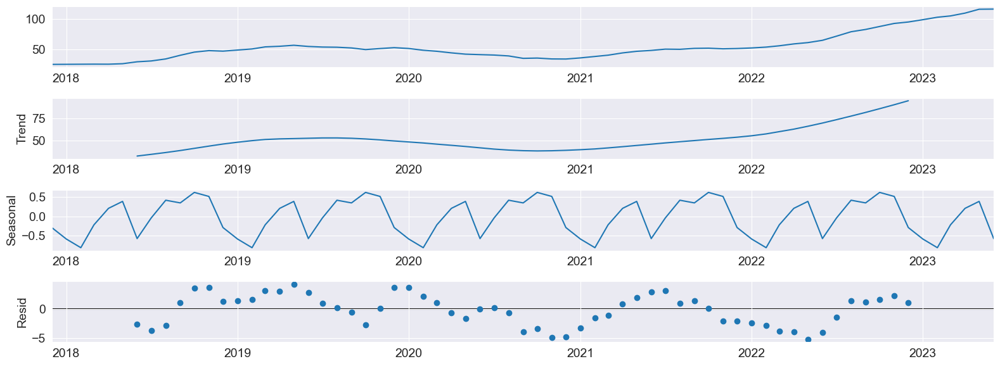

Empty DataFrame
Columns: [IPCA YOY %]
Index: []


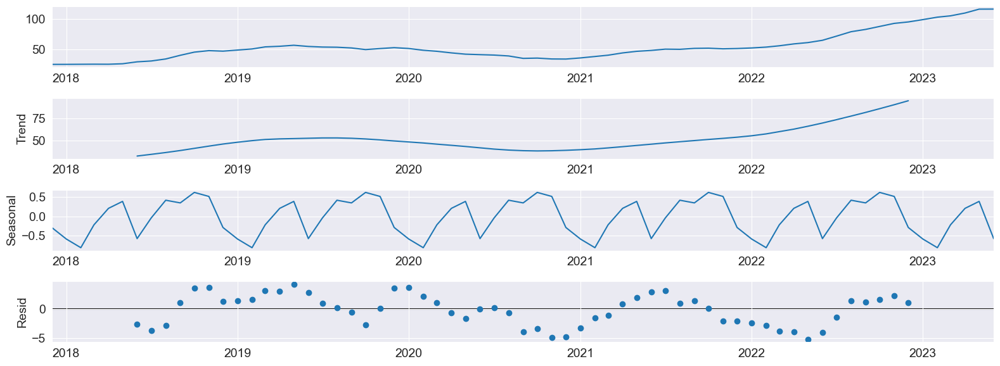

Bolivia: 


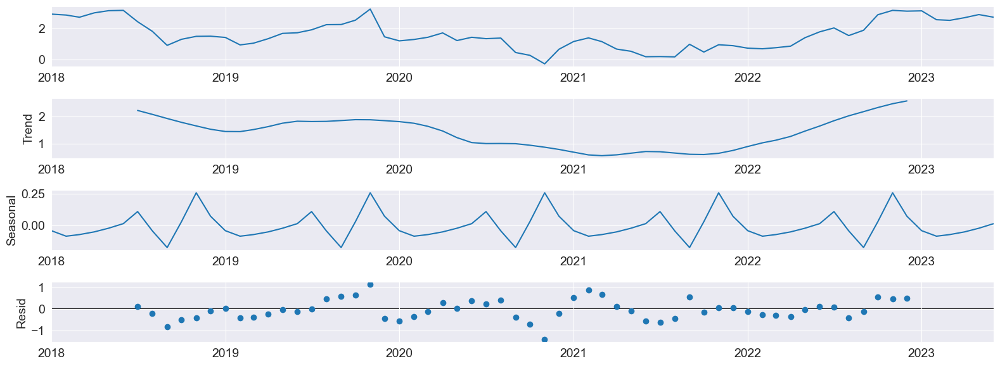

Empty DataFrame
Columns: [Indice de Precios al Consumidor a 12 meses_BOL_NSO]
Index: []


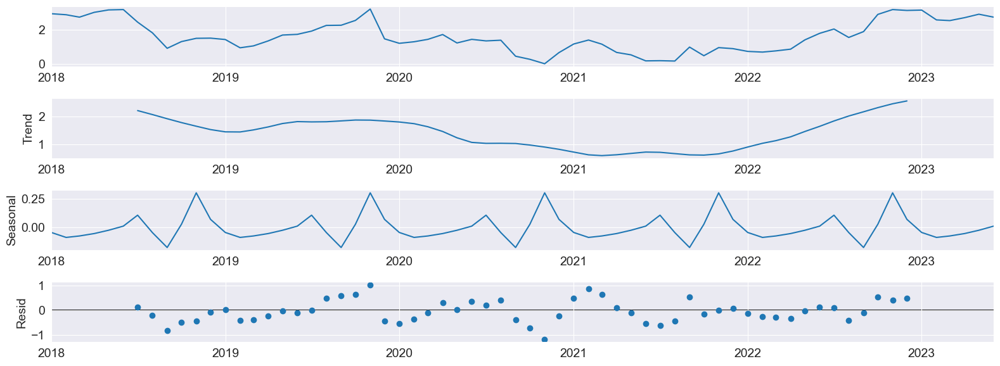

Brazil: 


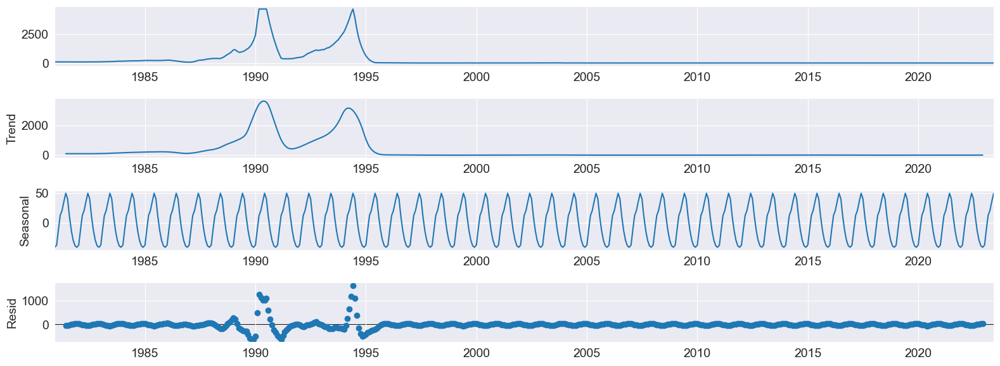

Empty DataFrame
Columns: [IPCA  - in 12 months (%)_BRA_CB]
Index: []


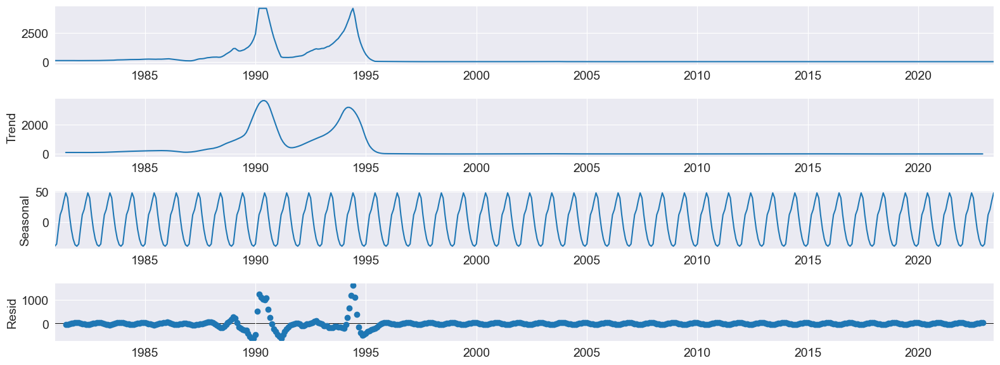

Chile: 


ValueError: This function does not handle missing values

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
for country in inst_data:
    print(country + ": ")

    #visualize outliers

    seasonal_decompose(inst_data[country], model='additive', period=12).plot()

    plt.show()

   
    inst_data[country] = inst_data[country].interpolate(method='linear', limit_direction='forward', axis=1)
    print(inst_data[country]['1928-11-01':'1929-03-01'])
   

    #quantile based flooring and capping

    inst_data[country] = inst_data[country].clip(lower=inst_data[country].quantile(0.01), upper=inst_data[country].quantile(0.99), axis=1)

    seasonal_decompose(inst_data[country], model='additive', period=12).plot()

    plt.show()



In [ ]:
'''
Next Steps:
- improve ARIMA by using with grid search for best parameters and best start date
- further data transforamtions before feeding into model
- get COL, URU, PER 
- write to Excel Report

****** DEMO to Ramon *****

-clean up code, make modular, deployable, readable

Add exog variables to ARIMA model
    - Exchange Rates
    - Interest Rates 
    - Oil Prices 

'''




<AxesSubplot: xlabel='Date'>

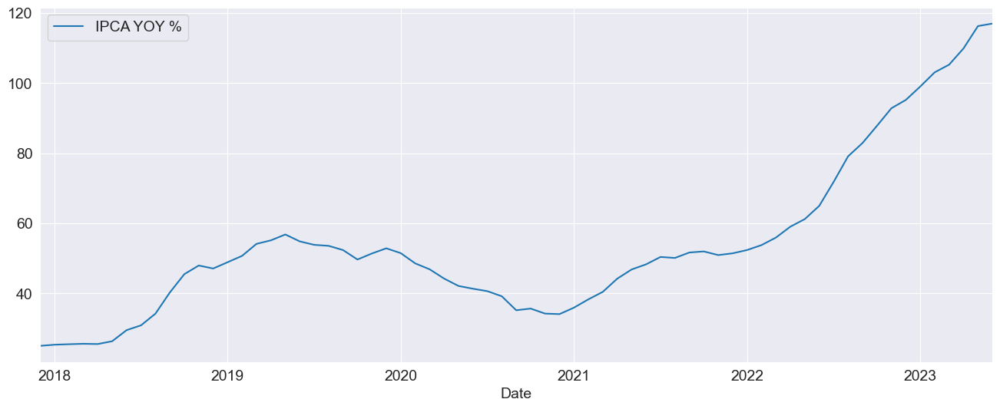

In [ ]:
inst_data['Argentina'].plot()